In [148]:
import os
import re
import subprocess
import networkx as nx
import scipy
import pydot
import pickle
import numpy as np
from tqdm.notebook import tqdm
import glob
import matplotlib.pyplot as plt
import pandas as pd

In [2]:
from lib.data import *
from lib.imports import *

OSError: dlopen(/usr/local/anaconda3/lib/python3.8/site-packages/torch_sparse/_convert_cpu.so, 0x0006): Symbol not found: __ZN2at8internal13_parallel_runExxxRKNSt3__18functionIFvxxmEEE
  Referenced from: /usr/local/anaconda3/lib/python3.8/site-packages/torch_sparse/_convert_cpu.so
  Expected in: /usr/local/anaconda3/lib/python3.8/site-packages/torch/lib/libtorch_cpu.dylib

In [121]:
inputs = '''
digraph D {

  A [shape=diamond]
  B [shape=box]
  C [shape=circle]

  A -> B [style=dashed, color=grey]
  A -> C [color="black:invis:black"]
  A -> D [penwidth=5, arrowhead=none]

}
'''

In [122]:
outputs = subprocess.check_output([f'hde/pmds'], text=True, input=inputs)

In [123]:
print(outputs)

digraph D {
	A	[pos="-0.000135,0.002141",
		shape=diamond];
	B	[pos="-28.029900,78.268596",
		shape=box];
	A -> B	[color=grey,
		style=dashed];
	C	[pos="81.799535,-14.861181",
		shape=circle];
	A -> C	[color="black:invis:black"];
	D	[pos="-53.769501,-63.409556"];
	A -> D	[arrowhead=none,
		penwidth=5];
}



In [11]:
def load_mtx(file):
    data = scipy.io.mmread(file)
    G = nx.from_scipy_sparse_matrix(data)
    return G

In [73]:
def get_pmds_layout(G, pmds_bin='hde/pmds'):
    indot = str(nx.nx.nx_pydot.to_pydot(G))
    outdot = subprocess.check_output([pmds_bin], text=True, input=indot)
    G = nx.nx_pydot.from_pydot(pydot.graph_from_dot_data(outdot)[0])
    raw_layout = nx.get_node_attributes(G, 'pos')
    return {int(n): tuple(map(float, pos.replace('"', '').split(','))) for n, pos in raw_layout.items()}

In [80]:
scalability = pd.read_csv(f"scalability.csv", index_col="index")

In [99]:
(idx, row), *_ = scalability.iterrows()

  0%|          | 0/537 [00:00<?, ?it/s]

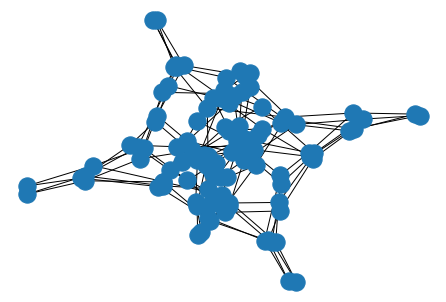

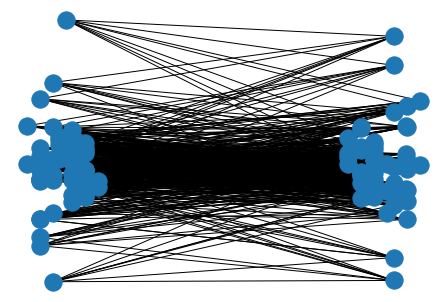

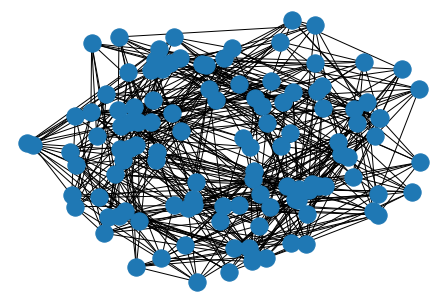

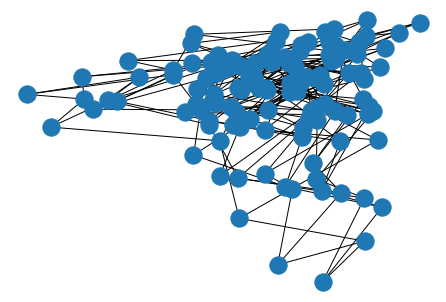

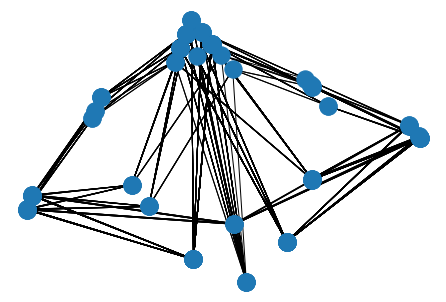

...

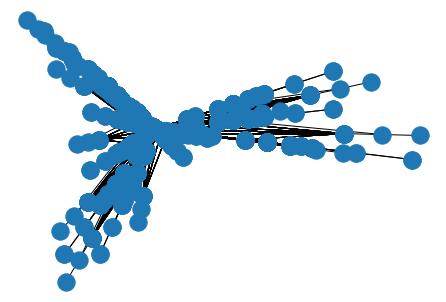

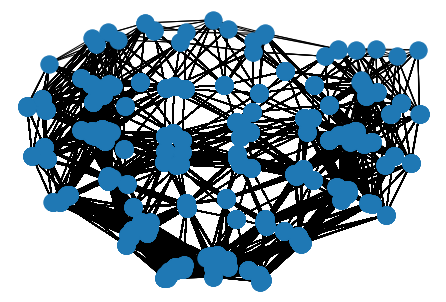

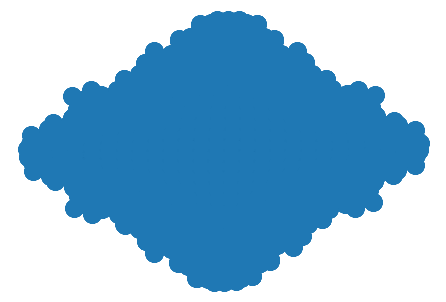

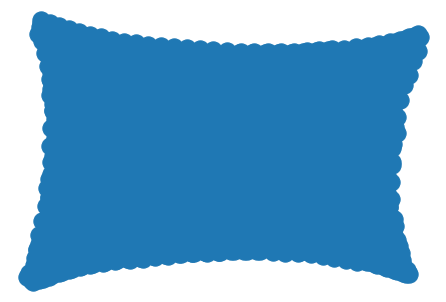

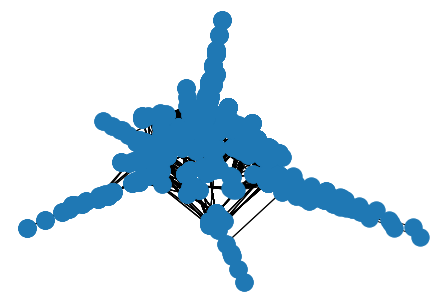

In [98]:
for idx, row in tqdm(scalability.iterrows(), total=len(scalability)):
    G = load_mtx(row['file'])
    layout = get_pmds_layout(G)
    pickle.dump(layout, open(f"layouts/new_large_graph/pmds/{row['name']}.pkl", "wb"))
    nx.draw(G, layout)
    plt.show()

  0%|          | 0/24 [00:00<?, ?it/s]

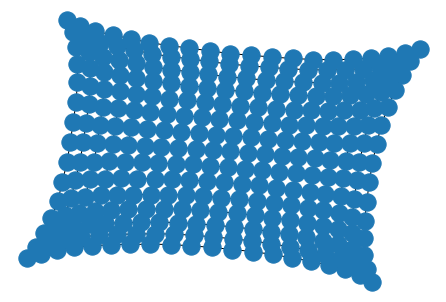

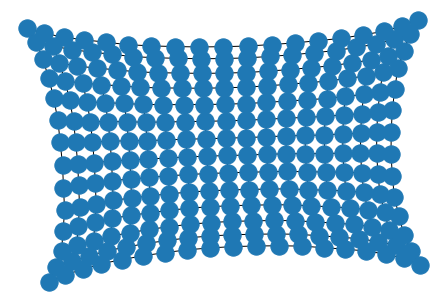

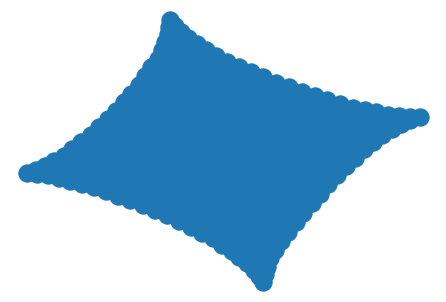

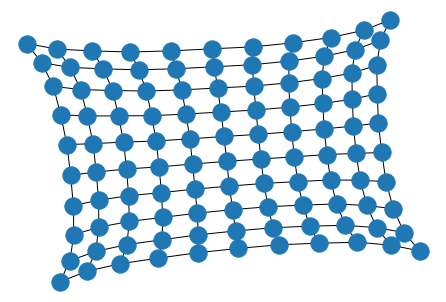

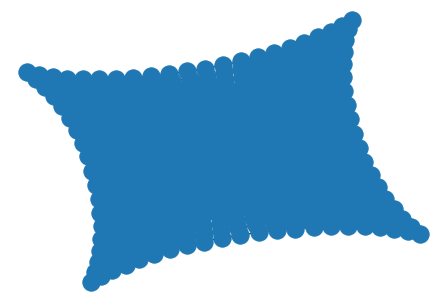

...

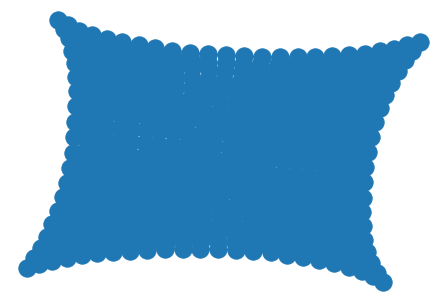

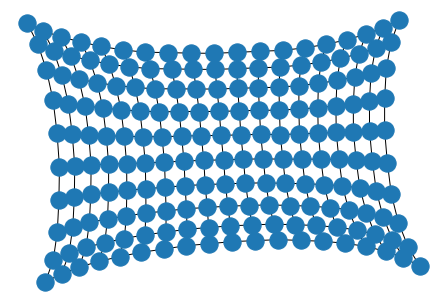

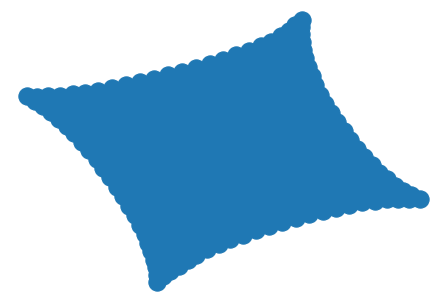

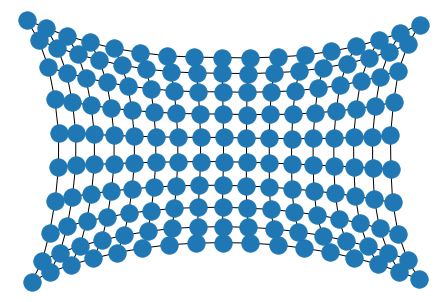

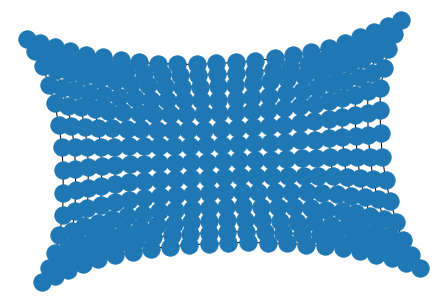

In [141]:
for file in tqdm(glob.glob("data/grid/*.pkl")):
    G = pickle.load(open(file, 'rb'))
    layout = get_pmds_layout(nx.Graph(G.edges))
    pickle.dump(layout, open(f"layouts/grid/pmds/{os.path.basename(file)}", "wb"))
    nx.draw(G, layout)
    plt.show()

In [166]:
grid_files = sorted(glob.glob("data/grid/*.pkl"), key=lambda f: tuple(map(int, re.findall('\d+', f))))

In [179]:
pos = []
for file in grid_files:
    name = os.path.basename(file)
    layout = pickle.load(open(f"layouts/grid/pmds/{name}", "rb"))
    sorted_layout = dict(sorted(layout.items(), key=lambda pair: pair[0]))
    pos.append(np.array(list(sorted_layout.values())))

In [181]:
np.save("layouts/grid/pos_pmds.npy", pos)

/usr/local/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)


In [184]:
pos = []
for idx, row in tqdm(scalability.iterrows(), total=len(scalability)):
    layout = pickle.load(open(f"layouts/new_large_graph/pmds/{row['name']}.pkl", "rb"))
    sorted_layout = dict(sorted(layout.items(), key=lambda pair: pair[0]))
    pos.append(np.array(list(sorted_layout.values())))

  0%|          | 0/537 [00:00<?, ?it/s]

In [185]:
np.save("layouts/new_large_graph/pos_pmds.npy", pos)

/usr/local/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)


In [139]:
subprocess.check_output(['hde/pmds'], text=True, input=indot)

'strict graph {\n\t0\t[pos="704.517773,464.016262"];\n\t1\t[pos="651.092628,447.687520"];\n\t0 -- 1;\n\t20\t[pos="670.625255,413.386450"];\n\t0 -- 20;\n\t2\t[pos="593.442703,433.276994"];\n\t1 -- 2;\n\t21\t[pos="618.252661,398.098148"];\n\t1 -- 21;\n\t20 -- 21;\n\t40\t[pos="643.752107,347.715875"];\n\t20 -- 40;\n\t3\t[pos="531.528637,424.682401"];\n\t2 -- 3;\n\t22\t[pos="562.514128,384.859774"];\n\t2 -- 22;\n\t21 -- 22;\n\t41\t[pos="592.520368,334.865451"];\n\t21 -- 41;\n\t4\t[pos="466.473128,418.715577"];\n\t3 -- 4;\n\t23\t[pos="502.738003,376.910722"];\n\t3 -- 23;\n\t22 -- 23;\n\t42\t[pos="538.114947,323.575564"];\n\t22 -- 42;\n\t5\t[pos="397.550269,417.508193"];\n\t4 -- 5;\n\t24\t[pos="440.250738,371.441710"];\n\t4 -- 24;\n\t23 -- 24;\n\t43\t[pos="479.898480,317.048385"];\n\t23 -- 43;\n\t6\t[pos="326.482205,417.917738"];\n\t5 -- 6;\n\t25\t[pos="374.490495,370.606649"];\n\t5 -- 25;\n\t24 -- 25;\n\t44\t[pos="419.401177,312.853520"];\n\t24 -- 44;\n\t7\t[pos="253.327684,422.879104"];\n\

In [74]:
G = load_mtx(files[1])

In [75]:
layout = get_pmds_layout(G)

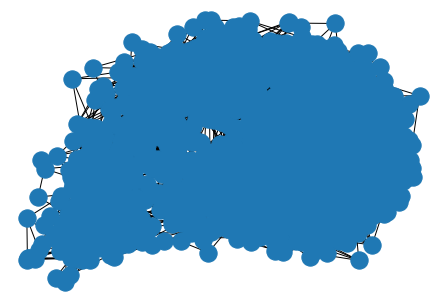

In [76]:
nx.draw(G, layout)

In [8]:
G_list = load_G_list(data_path='data/rome', index_file='deepgd/data_index.txt', cache='G_list.pickle')

NameError: name 'load_G_list' is not defined

In [16]:
pmds_G_list = []
for i in tqdm(range(len(G_list))):
    dot_path = f'rome_dot/{i}.dot'
    pmds_path = f'rome_dot/{i}.pmds.dot'
    nx.drawing.nx_agraph.write_dot(G_list[i], dot_path)
    subprocess.run([f'hde/pmds'], text=True, stdin=open(dot_path), stdout=open(pmds_path, 'w'))
    pmds_G_list.append(nx.drawing.nx_agraph.read_dot(pmds_path))

In [32]:
pmds_list = []
for pmds_G in tqdm(pmds_G_list):
    pmds_list.append(np.array([list(map(float, pmds_G.nodes[str(i)]['pos'].split(','))) for i in range(pmds_G.number_of_nodes())]))

In [36]:
pickle.dump(pmds_list, open('pmds_list.pickle', 'wb'))

In [14]:
Batch.from_data_list([Data(sparsity=torch.tensor([[0.5, 0.5, 0.5]])), Data(sparsity=torch.tensor([[0.5, 0.5, 0.5]]))]).sparsity.shape[1]

3